# Goal: EDA on PJM generation data 

In [57]:
import pandas as pd
import numpy as np

from pathlib import Path


path = Path("../eia_data/generation_pjm")

dt_cols = ["datetime_beginning_utc","datetime_beginning_ept"]

df= pd.concat([pd.read_csv(f,parse_dates=dt_cols,) for f in path.glob("*.csv")])

/var/folders/bw/949q2z111js28qksbjv6ww_m0000gn/T/ipykernel_20900/3133855930.py:11: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df= pd.concat([pd.read_csv(f,parse_dates=dt_cols,) for f in path.glob("*.csv")])
/var/folders/bw/949q2z111js28qksbjv6ww_m0000gn/T/ipykernel_20900/3133855930.py:11: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df= pd.concat([pd.read_csv(f,parse_dates=dt_cols,) for f in path.glob("*.csv")])
/var/folders/bw/949q2z111js28qksbjv6ww_m0000gn/T/ipykernel_20900/3133855930.py:11: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df= pd.concat([pd.read_csv(f,pa

# Create new features

In [58]:
df["year"] = df.datetime_beginning_utc.dt.year
df["fuel_type"] = df.fuel_type.str.lower()

In [60]:
cfe_mapping = pd.DataFrame([{"coal":False,"gas":False,"hydro":True,"multiple fuels":False,
 "nuclear":True,"oil":False,"other":False,"Other Renewables":True,
 "solar":True,"Storage":True,"Wind":True}]).T.reset_index()

cfe_mapping = cfe_mapping.rename(columns={"index":"fuel_type",0:"is_cfe"})

In [61]:
df = df.merge(cfe_mapping,on="fuel_type",how="left")

# Generation Overtime

In [123]:
import plotly.express as px

In [124]:
plot_data = df.groupby(["year","fuel_type","is_cfe"]).agg({"mw":"sum"}).reset_index().query('year < 2024')

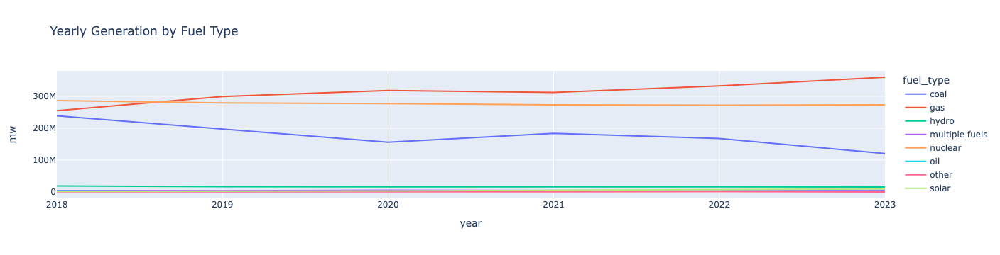

In [125]:
px.line(plot_data,x="year",y="mw",color="fuel_type",title="Yearly Generation by Fuel Type")

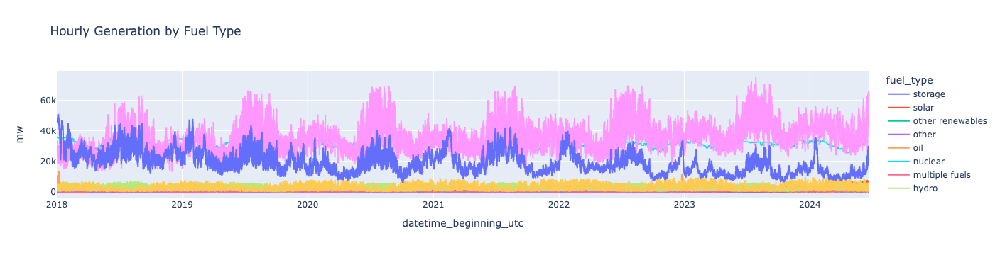

In [135]:
px.line(df.sort_values("datetime_beginning_utc"),x="datetime_beginning_utc",y="mw",color="fuel_type",title="Hourly Generation by Fuel Type")

# Generation Mix Percentages

## CFE

- Fluctuates by a percent

In [136]:

df.groupby(["year","is_cfe"]).agg({"mw":"sum"})/df.groupby("year").agg({"mw":"sum"})

mw
year is_cfe          
2018 False   0.600471
     True    0.366848
2019 False   0.605101
     True    0.359296
2020 False   0.595459
     True    0.366014
2021 False   0.604331
     True    0.355360
2022 False   0.604084
     True    0.351196
2023 False   0.594547
     True    0.363274
2024 False   0.582765
     True    0.366271

# Renewable

- Has increased by a percent YOY

In [139]:

df.groupby(["year","is_renewable"]).agg({"mw":"sum"})/df.groupby("year").agg({"mw":"sum"})

mw
year is_renewable          
2018 False         0.942427
     True          0.057573
2019 False         0.941559
     True          0.058441
2020 False         0.937200
     True          0.062800
2021 False         0.932594
     True          0.067406
2022 False         0.927737
     True          0.072263
2023 False         0.927340
     True          0.072660
2024 False         0.909136
     True          0.090864

# Check for data completeness

- All but one is less than 1 in amount of days to be expected.

In [140]:
hours_in_year = 8760

data_completeness_check = round((df.groupby(["year","fuel_type"]).agg({"mw":"sum","datetime_beginning_ept":"count"})/hours_in_year),2)

data_completeness_check[:"2023"]["datetime_beginning_ept"].value_counts()

datetime_beginning_ept
1.00    64
0.99     1
0.13     1
Name: count, dtype: int64